In [1]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import pymc3 as pm
import theano.tensor as tt
import exoplanet as xo

import radvel

import astropy.units as u
import astropy.constants as co

/Users/neisner/opt/anaconda3/envs/exoplanet/lib/python3.9/site-packages/radvel/gp.py:32: ImportWarning: celerite not installed. GP kernals using celerite will not work. Try installing celerite using 'pip install celerite'
  warnings.warn("celerite not installed. GP kernals using celerite will not work. \


In [2]:
period = 1.1047115
t0 = 2398.164
    
def get_etv_data(files):

    period = 1.1047115
    t0 = 2398.164
    
    x_etv =  []
    y_etv =  []
    yerr_etv  = []
    yerr_etv2 = []
    
    for file in files:
        in_df = pd.read_csv(file)

        in_df['midpoint'] = in_df['epoch'] + (in_df['t0']*period)
        in_df['shift_mins'] = in_df['t0']*period*24*60
        in_df['std_mins'] = in_df['stdv']*period*24*60
        

        x_etv.append(np.array(list(in_df['epoch'])))
        y_etv.append(np.array(list(in_df['shift_mins'])))
        yerr_etv.append(np.array(list(in_df['std_mins'])))
      
    
    x_etv = np.hstack(x_etv)
    y_etv = np.hstack(y_etv)
    yerr_etv = np.hstack(yerr_etv)

    
    p4 = 4.092
    t04 = 1765.17
    
    for i in range(0,55):
        
        time = t04 + (i*p4)
        
        mask = (x_etv > time - 0.15) & (x_etv < time + 0.15)
        
        x_etv = x_etv[~mask]
        y_etv = y_etv[~mask]
        yerr_etv = yerr_etv[~mask]
    
    #print (len(x_etv), len(y_etv), len(yerr_etv), len(yerr_etv2))
    
    return x_etv, y_etv, yerr_etv
    
    
def get_rv_data(file):

    data_rv = pd.read_csv(file, delimiter = ' ', names = ['time', 'rv', 'snr', 'err'])

    data_rv['time_tjd'] = data_rv['time'] - 2457000.0

    x_rv = np.array(data_rv['time_tjd'].tolist())
    y_rv = np.array(data_rv['rv'].tolist())
    yerr_rv = np.array(data_rv['err'].tolist())

    return x_rv, y_rv, yerr_rv


In [3]:
from glob import glob 


files = sorted(glob('/Users/neisner/Documents/projects/fluffy/reanalysed/onedaysignal/mcmc_etvs_*csv'))

#print (files)

x_etv, y_etv, yerr_etv = get_etv_data(files)


t, rv, rv_err = get_rv_data('/Users/neisner/Documents/projects/fluffy/HERMES_extracted/mean_helium_rvs_snr.txt')
x_etv, y_etv, yerr_etv = zip(*sorted(zip(x_etv,y_etv,yerr_etv)))

rv_dat = pd.read_csv('/Users/neisner/Documents/projects/fluffy/HERMES_extracted/mean_helium_rvs_snr.txt', delimiter = ' ', names = ['t', 'rv', 'snr', 'err'])
#fig, ax = plt.subplots(figsize=(8, 3))

#plt.errorbar(rv_dat.t, rv_dat.rv, yerr = rv_error, lw = 0, elinewidth = 2, marker = '.')

rv_error = ((rv_dat.snr - np.max(rv_dat.snr))/(np.min(rv_dat.snr) - np.max(rv_dat.snr))) * (7) + 2

x = t
y = np.array(rv) + 40
yerr = np.array(rv_error)

x_etv = np.array(x_etv)
y_etv = np.array(y_etv)
yerr_etv = np.array(yerr_etv) * 7
#yerr_etv2 = np.array(yerr_etv2) * 2

err_mask = (yerr_etv <2) #& (x_etv < 2400 )

x_etv = x_etv[err_mask]
y_etv = y_etv[err_mask]
yerr_etv = yerr_etv[err_mask] 

x_etv = x_etv #- t0
x = x #- t0

print (yerr_etv)

[1.25229049 1.73725106 1.2876864  1.71625486 1.29115679 1.77806553
 1.27833665 1.75451749 1.2207737  1.72534184 1.22724053 1.70685731
 1.24216484 1.25061366 1.66413528 1.83696291 1.27933887 1.69339815
 1.29801247 1.6952282  1.28555356 1.79458629 1.3419485  1.75054757
 1.26090047 1.70560047 1.26098853 1.74701173 1.26969104 1.29153685
 1.66157297 1.26863138 1.7372623  1.68673451 1.27916783 1.74852137
 1.84084609 1.38163468 1.26575981 1.73754939 1.25086809 1.72984913
 1.26888343 1.74055049 1.26770411 1.72702433 1.31935055 1.70265947
 1.28986232 1.75668328 1.24002994 1.71491749 1.25711862 1.72167386
 1.40509699 1.70109982 1.26896605 1.69085922 1.24531866 1.85766409
 1.2572398  1.62623849 1.32587696 1.70549521 1.2739634  1.276003
 1.74374522 1.33821985 1.7568896  1.24823243 1.67632479 1.26329879
 1.76709143 1.2724411  1.73266666 1.29601086 1.7527722  1.26332963
 1.70695319 1.30766324 1.67157475 1.28566124 1.75205872 1.24355867
 1.71379338 1.31775825 1.74050924 1.40543401 1.81715578 1.714171

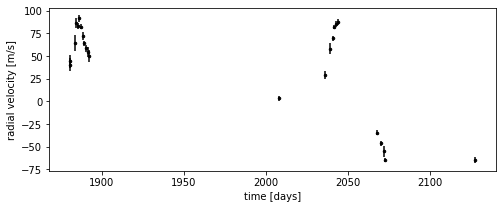

In [4]:
import pymc3 as pm
import theano.tensor as tt

# Compute a reference time that will be used to normalize the trends model
x_ref = 0.5 * (np.nanmin(x) + np.nanmax(x))

fig, ax = plt.subplots(figsize=(8, 3))

# Also make a fine grid that spans the observation window for plotting purposes
t = np.linspace(np.nanmin(x) - 5, np.nanmax(x) + 5, 1000)

plt.errorbar(x, y, yerr=yerr, fmt=".k")
plt.xlabel("time [days]")
_ = plt.ylabel("radial velocity [m/s]")

In [5]:
#import exoplanet as xo
#
#periods = [52.1, 9]
#period_errs = [2,2]
#t0s = [1878.738,1899.990] #[1878.1478847143728,1895.00335]
#t0_errs = [52*0.5, 2]
#Ks = [78, 4] #xo.estimate_semi_amplitude(periods, x, y, yerr, t0s=t0s)
#print(Ks, "m/s")

periods = [52.1, 9.9733]
period_errs = [5, 0.0001]
t0s = [1878.738,1899.990] #[1878.1478847143728,1895.00335]
t0_errs = [52*0.5, 2]
Ks = [78, 4] #xo.estimate_semi_amplitude(periods, x, y, yerr, t0s=t0s)
print(Ks, "m/s")

[78, 4] m/s


In [6]:
def timetrans_to_timeperi(tc, per, ecc, omega):

    f = np.pi/2 - omega
    ee = 2 * np.arctan(np.tan(f/2) * np.sqrt((1-ecc)/(1+ecc)))  # eccentric anomaly
    tp = tc - per/(2*np.pi) * (ee - ecc*np.sin(ee))      # time of periastron

    return tp



In [7]:
import pymc3 as pm
import theano.tensor as tt
from exoplanet.orbits import get_true_anomaly

P12 = 1.1047
t012 =  1766.28 
M3 = 15

with pm.Model() as model:

    # Gaussian priors based on transit data (from Petigura et al.)
    t0 = pm.Normal("t0", mu=np.array(t0s), sd=np.array(t0_errs), shape=2)
    t03 = pm.Deterministic('t03', t0[0])

    P = pm.Bound(pm.Normal, lower=1)("P",mu=np.array(periods),sd=np.array(period_errs),shape=2,testval=np.array(periods),)
    P3 = pm.Deterministic('P3', P[0])
    
    # Wide log-normal prior for semi-amplitude
    logK = pm.Bound(pm.Normal, lower=0)("logK", mu=np.log(Ks), sd=20, shape=2, testval=np.log(Ks))
    
    # Eccentricity & argument of periasteron
    #ecc = pm.Normal("ecc", mu = np.array([0.28, 0]), sd =np.array([0.1, 0.1]), shape=2, testval=np.array([0.28, 0.02]))
    
    ecc = pm.Bound(pm.Normal, lower=np.array([0, 0]), upper=np.array([0.40, 0.1]))('ecc', mu = np.array([0.28, 0]), sd =np.array([0.1, 0.1]), testval=np.array([0.28, 0.02]), shape = 2)
    ecc3 = pm.Deterministic('ecc3', ecc[0])
    
    omega = pm.Uniform("omega", shape=2, lower = np.array([-np.pi, -np.pi]), upper = np.array([0,0]), testval=np.array([-1.62, -np.pi/2]))
    omega3 = pm.Deterministic('omega3', omega[0])

    tp3 = pm.Deterministic("tp3", timetrans_to_timeperi(t03, P3, ecc3, omega3))
    
    # Priors
    c0 = pm.Normal("c0",mu=0,sd=5,testval=0)   
    c1 = pm.Normal("c1",mu=0,sd=0.5,testval=0)
    c2 = pm.Normal("c2",mu=0,sd=0.0001,testval=0)
    

    mass_ratio = pm.Normal("mass_ratio",mu=0.584,sd = 0.2, testval=0.584)
    
    i_mutual = pm.Uniform("i_mutual", lower = 0, upper = np.pi/2,  testval= 1.5)
    g2 = pm.Uniform("g2", lower =  -np.pi/2, upper = np.pi/2, testval= 0.6)

    #asini = (1.9758 * 10e-2) * (1-ecc12**2) ** (0.5) * k12 * P12
    #asini = pm.Deterministic("asini" + name,(1.9758 * 10e-2) * (1-ecc12**2) ** (0.5) * k12 * P12)
    asini = pm.Uniform("asini", lower=10, upper=500, testval=100)
    
    # Jitter & a quadratic RV trend
    logs = pm.Normal("logs", mu=np.log(np.median(yerr)), sd=5.0)
    trend = pm.Normal("trend", mu=0, sd=10.0 ** -np.arange(3)[::-1], shape=3)

    # Then we define the orbit
    
    orbit = xo.orbits.KeplerianOrbit(period=P, t_periastron=t0, ecc=ecc, omega=omega)


    # And a function for computing the full RV model
    def get_rv_model(t, name=""):
        # First the RVs induced by the planets
        vrad = orbit.get_radial_velocity(t, K=tt.exp(logK))
        pm.Deterministic("vrad" + name, vrad)

        # Define the background model
        A = np.vander(t - x_ref, 3)
        bkg = pm.Deterministic("bkg" + name, tt.dot(A, trend))

        # Sum over planets and add the background to get the full model
        return pm.Deterministic("rv_model" + name, tt.sum(vrad, axis=-1) + bkg)

    # Define the RVs at the observed times
    rv_model = get_rv_model(x)

    # Also define the model on a fine grid as computed above (for plotting)
    rv_model_pred = get_rv_model(t, name="_pred")

    # Finally add in the observation model. This next line adds a new contribution
    # to the log probability of the PyMC3 model
    err = tt.sqrt(yerr ** 2 + tt.exp(2 * logs))
    pm.Normal("obs", mu=rv_model, sd=err, observed=y)
    
    
    def etv_dyn(t, P3, tp, ecc3, i_mutual, mass_ratio, g2):
        

        M = tt.zeros_like(tt.constant(t)) + 2.0 * np.pi * (tt.constant(t)) / P3
        true_anom3 = get_true_anomaly(M, ecc3 + tt.zeros_like(M))
    
    
        MM = ((3. * ecc3 * np.sin(true_anom3)) - ( (3./4.) * (ecc3**2) * (np.sin(2*true_anom3))) + ((1/3.) * (ecc3**3) * (np.sin(3*true_anom3))))
        SS = np.sin((2* true_anom3) + (2*g2)) + (ecc3 * (np.sin(true_anom3 + (2*g2)) + (1/3. * np.sin((3.*true_anom3) + (2 * g2)))))
        
        delta_dyn = (((3. / (4 * np.pi)) * (mass_ratio) * (((P12)**2)/(P3)) * (1. - (ecc3**2))**(-3./2)) *
                    ((((2./3) - (np.sin(i_mutual)**2)) * MM) + (0.5*(np.sin(i_mutual)**2) * SS))) * 1440
        
        return delta_dyn
    
    
    def etv_ltte(t, c0, c1, c2, t012, P12, P3, tp, ecc3, asini):
        
        E = abs(np.round((t - t012) / P12, 1))

        M = tt.zeros_like(tt.constant(t)) + 2.0 * np.pi * (tt.constant(t)) / P3
        
        true_anom3 = get_true_anomaly(M, ecc3 + tt.zeros_like(M))
    
        #true_anom3 = radvel.orbit.true_anomaly(t, tp, P3, ecc3)
        
        # convert from Rsun to m
        asini_m  = asini * 696000000 
        c = 299792458 # m/s
        
        delta_LTTE = - (((asini_m)/c) * (((1 - (ecc3**2.)) * np.sin(true_anom3 + omega3)) / (1 + ecc3*np.cos(true_anom3)))) / 60 # convert from seconds to minutes
        
        return c0 + (c1*E) + (c2*E**2) + (delta_LTTE)
        
        
    def etv_model(t, c0, c1, c2, t012, P12, P3, tp, ecc3, omega3, i_mutual, mass_ratio, asini, g2, name=""):
        
        delta_dyn = pm.Deterministic('delta_dyn' + name, etv_dyn(t, P3, tp, ecc3, i_mutual, mass_ratio, g2))
        delta_LTTE = pm.Deterministic('delta_ltte' + name, etv_ltte(t, c0, c1, c2, t012, P12, P3, tp, ecc3, asini))
            
        return pm.Deterministic("etv_model" + name, delta_dyn + delta_LTTE)
    
     
    # Expected value of outcome
    x_etv_array = np.arange(np.nanmin(x_etv) - 10, np.nanmax(x_etv) + 10, P12/2)
    
    #etvmodel = pm.Deterministic('etvmodel', etv_model(x_etv, t012, c0, c1, c2, P12, P3, tp, e3, omega3, i_mutual, M123, asini, g2))
    #etvmodel_pred = pm.Deterministic('etvmodel_pred', etv_model(x_etv_array, t012, c0, c1, c2, P12, P3, tp, e3, omega3, i_mutual, M123, asini, g2))
    
    etvmodel = etv_model(x_etv, c0, c1, c2,t012, P12, P3, tp3, ecc3, omega3, i_mutual, mass_ratio, asini, g2)
    etvmodel_pred = etv_model(x_etv_array, c0, c1, c2, t012, P12, P3, tp3, ecc3, omega3, i_mutual, mass_ratio, asini, g2, name = '_pred')
    
    # Condition on the observations
    pm.Normal("obs_etv", mu=etvmodel, sd=yerr_etv, observed=y_etv)


In [8]:
import pymc3_ext as pmx

with model:
    map_params = pmx.optimize()
    

optimizing logp for variables: [trend, logs, asini, g2, i_mutual, mass_ratio, c2, c1, c0, omega, ecc, logK, P, t0]


message: Desired error not necessarily achieved due to precision loss.
logp: -1026.8323737038736 -> -421.3500429477126


<IPython.core.display.Javascript object>


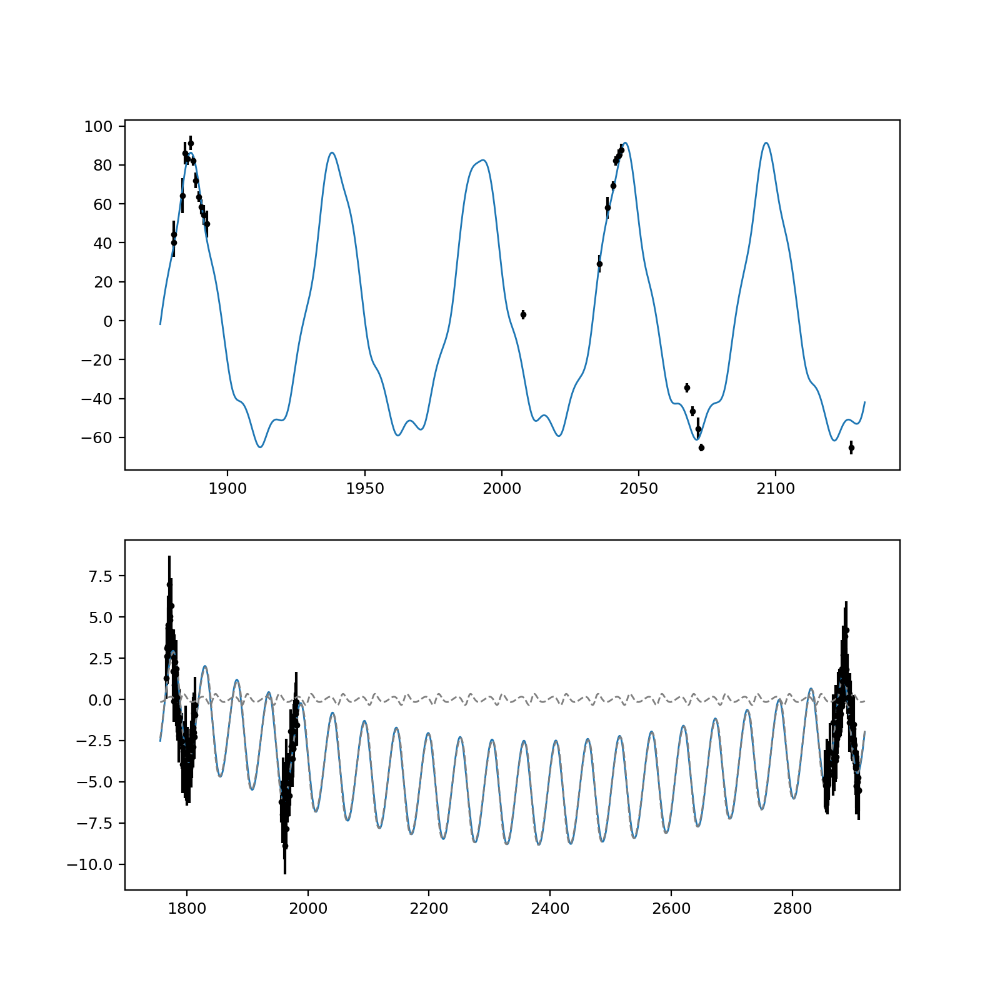

In [9]:
%matplotlib notebook 

fig, ax = plt.subplots(2, 1, figsize=(8, 8))

ax[0].errorbar(x, y, yerr=yerr, fmt=".k")
ax[0].plot(t, map_params["rv_model_pred"], color="C0", lw=1)

ax[1].errorbar(x_etv, y_etv, yerr=yerr_etv, fmt=".k")
ax[1].plot(x_etv_array, map_params["etv_model_pred"], color="C0", lw=1)
ax[1].plot(x_etv_array, map_params["delta_dyn_pred"], ls = '--', color="grey", lw=1)
ax[1].plot(x_etv_array, map_params["delta_ltte_pred"], ls = '--', color="grey", lw=1)


In [10]:
with model:
    map_soln = pmx.optimize(start=model.test_point, vars=[trend])
    map_soln = pmx.optimize(start=map_soln)

optimizing logp for variables: [trend]


message: Optimization terminated successfully.
logp: -1026.8323737038736 -> -1023.9880753649182
optimizing logp for variables: [trend, logs, asini, g2, i_mutual, mass_ratio, c2, c1, c0, omega, ecc, logK, P, t0]


message: Desired error not necessarily achieved due to precision loss.
logp: -1023.9880753649182 -> -421.2787832016429


<IPython.core.display.Javascript object>


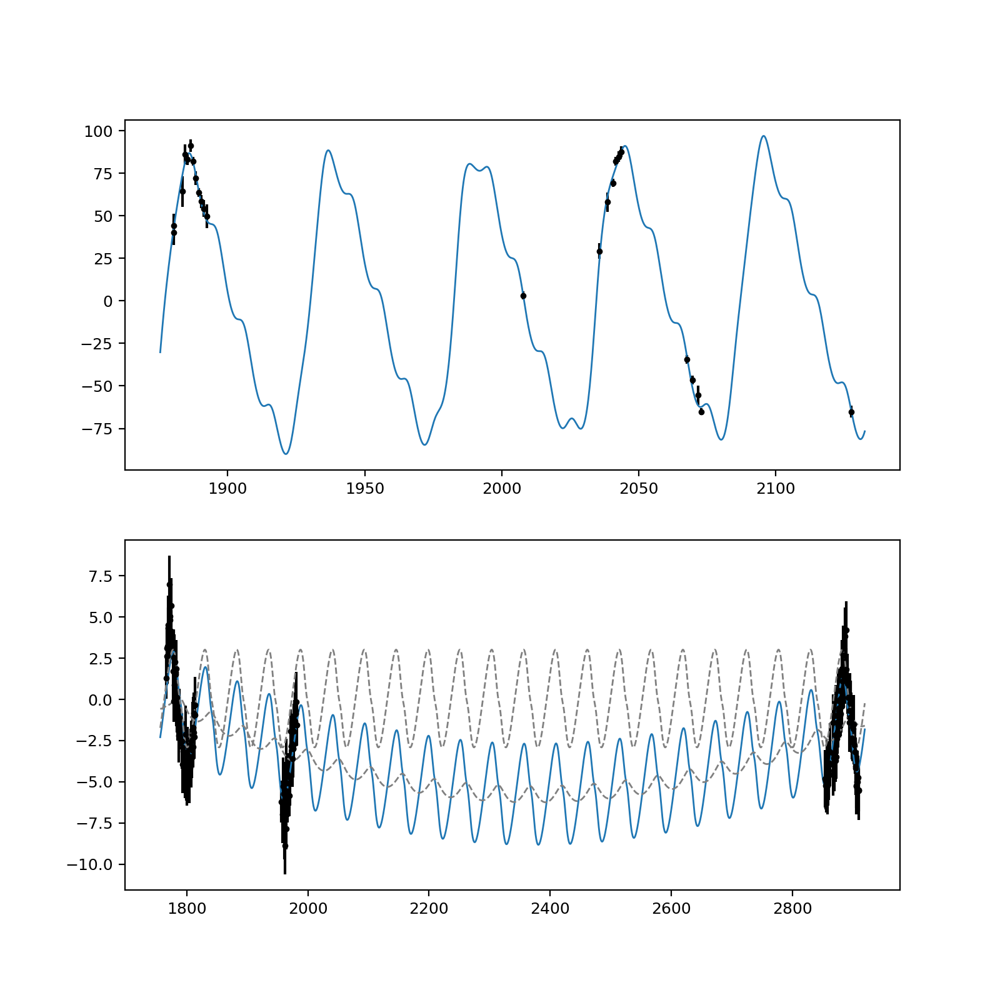

In [11]:
fig, ax = plt.subplots(2, 1, figsize=(8, 8))

ax[0].errorbar(x, y, yerr=yerr, fmt=".k")
ax[0].plot(t, map_soln["rv_model_pred"], color="C0", lw=1)

ax[1].errorbar(x_etv, y_etv, yerr=yerr_etv, fmt=".k")
ax[1].plot(x_etv_array, map_soln["etv_model_pred"], color="C0", lw=1)
ax[1].plot(x_etv_array, map_soln["delta_dyn_pred"], ls = '--', color="grey", lw=1)
ax[1].plot(x_etv_array, map_soln["delta_ltte_pred"], ls = '--', color="grey", lw=1)


In [12]:
np.random.seed(42)

with model:
    trace = pm.sample(
        tune=4000,
        draws=4000,
        cores=2,
        chains=2,
        target_accept=0.95,
        init="adapt_full")

Auto-assigning NUTS sampler...
Initializing NUTS using adapt_full...
Multiprocess sampling (2 chains in 2 jobs)
NUTS: [trend, logs, asini, g2, i_mutual, mass_ratio, c2, c1, c0, omega, ecc, logK, P, t0]
WARNING (theano.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (theano.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


Sampling 2 chains for 4_000 tune and 4_000 draw iterations (8_000 + 8_000 draws total) took 87 seconds.
The number of effective samples is smaller than 25% for some parameters.


In [13]:
pm.summary(trace, var_names=["trend", "logs", "omega", "ecc", "t0", "c0", "c1", "c2", "logK", "P", "mass_ratio", "i_mutual", "g2", "asini"])


Got error No model on context stack. trying to find log_likelihood in translation.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
trend[0],-0.000,0.000,-0.001,0.000,0.000,0.000,5822.0,4951.0,1.00
trend[1],-0.014,0.049,-0.106,0.079,0.001,0.001,6546.0,5344.0,1.00
trend[2],0.535,0.984,-1.350,2.340,0.009,0.010,10856.0,6489.0,1.00
logs,2.358,0.187,2.013,2.703,0.002,0.002,7685.0,5776.0,1.00
omega[0],-0.028,0.032,-0.084,-0.000,0.001,0.000,3451.0,3752.0,1.00
omega[1],-1.513,0.981,-3.036,-0.048,0.016,0.011,4116.0,5148.0,1.00
ecc[0],0.264,0.054,0.164,0.366,0.001,0.001,3567.0,3194.0,1.00
ecc[1],0.046,0.028,0.000,0.092,0.000,0.000,9907.0,5196.0,1.00
t0[0],1886.076,0.500,1885.123,1887.019,0.007,0.005,5106.0,4666.0,1.00
t0[1],1899.823,2.551,1895.434,1904.267,0.048,0.034,3109.0,5750.0,1.00


In [14]:
import astropy.units as u

ecc3 = 0.314
k3 = np.exp(4.351)
P3 = 52.093

ecc4 = 0.045
k4 = np.exp(1.667)
P4 = 9.973

asini3 = (1.9758 * 10e-2) * (1-ecc3**2) ** (0.5) * k3 * P3
asini4 = (1.9758 * 10e-2) * (1-ecc4**2) ** (0.5) * k4 * P4

print (asini3, asini4)

757.8746509018105 10.425515360381782


In [15]:
import corner

samples = pm.trace_to_dataframe(trace, varnames=["trend", "logs", "omega", "ecc", "t0", "c0", "c1", "c2", "logK", "P", "mass_ratio", "i_mutual", "g2", "asini"])
_ = corner.corner(samples)



Pandas support in corner is deprecated; use ArviZ directly


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


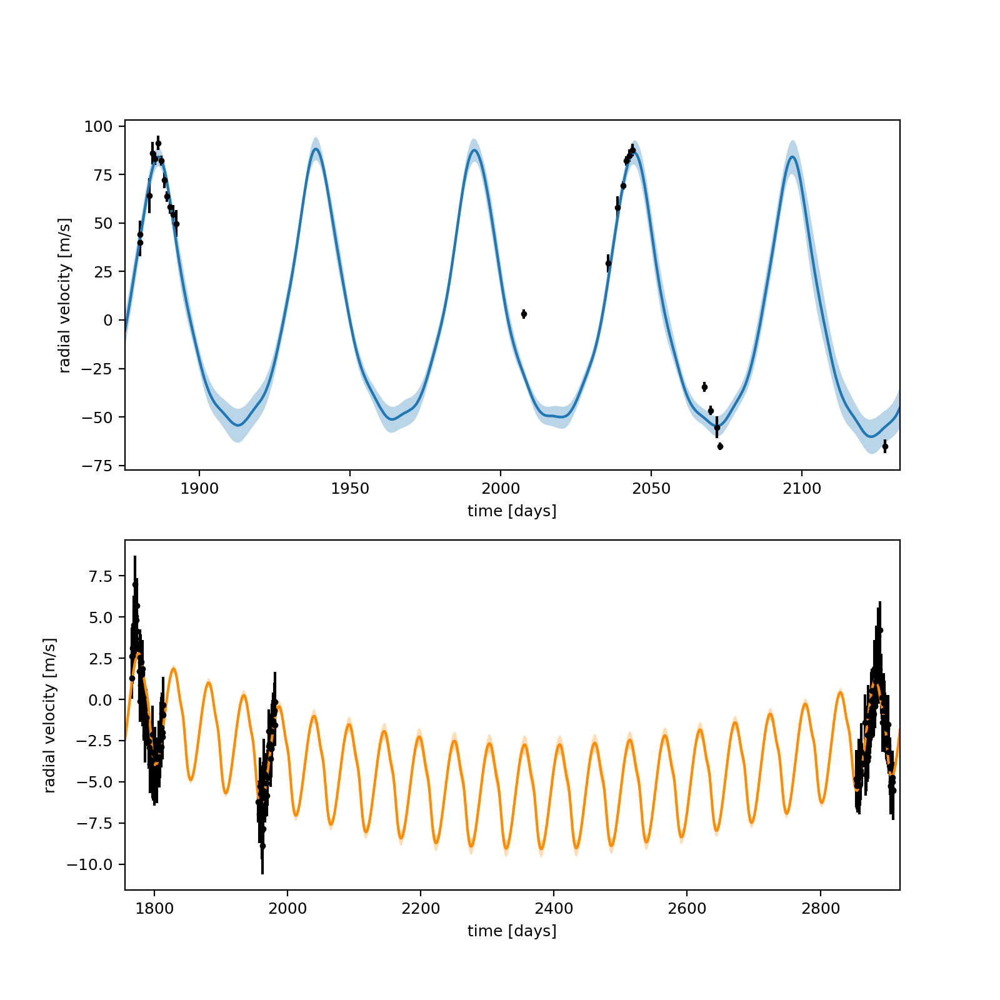

In [16]:
%matplotlib notebook
fig, ax = plt.subplots(2,1, figsize=(8,8))

ax[0].errorbar(x, y, yerr=yerr, fmt=".k")

# Compute the posterior predictions for the RV model
pred = np.percentile(trace["rv_model_pred"], [16, 50, 84], axis=0)
ax[0].plot(t, pred[1], color="C0", label="model")
art = ax[0].fill_between(t, pred[0], pred[2], color="C0", alpha=0.3)
art.set_edgecolor("none")

#ax[0].legend(fontsize=10)
ax[0].set_xlim(t.min(), t.max())
ax[0].set_xlabel("time [days]")
ax[0].set_ylabel("radial velocity [m/s]")
#_ = ax[0].set_title("posterior constraints")


# Compute the posterior predictions for the RV model
ax[1].errorbar(x_etv, y_etv, yerr=yerr_etv, fmt=".k")

pred = np.percentile(trace["etv_model_pred"], [16, 50, 84], axis=0)
ax[1].plot(x_etv_array, pred[1], color="darkorange", label="model")
art = ax[1].fill_between(x_etv_array, pred[0], pred[2], color="darkorange", alpha=0.3)
art.set_edgecolor("none")

#ax[1].legend(fontsize=10)
ax[1].set_xlim(x_etv_array.min(), x_etv_array.max())
ax[1].set_xlabel("time [days]")
ax[1].set_ylabel("radial velocity [m/s]")
#_ = ax[1].set_title("posterior constraints")

plt.show()


<IPython.core.display.Javascript object>


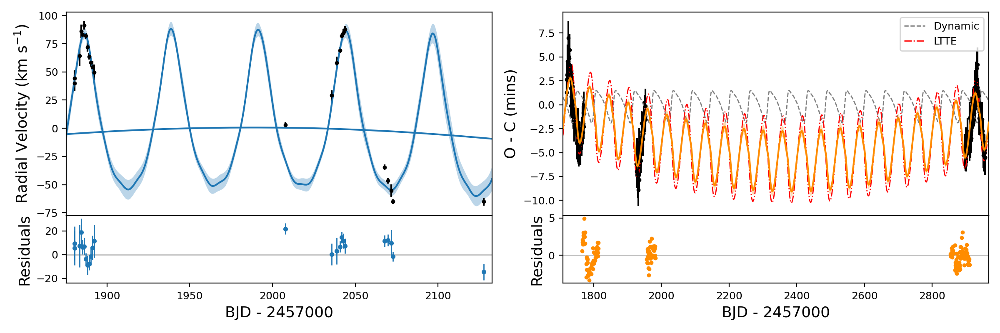

[[-11.3781337  -11.33013405 -11.28457716 ... -19.69142845 -19.75637837
  -19.81955593]
 [ -5.24556187  -5.21376163  -5.19403406 ...  -9.24617443  -9.2830722
   -9.31073664]
 [  0.87090718   0.87456771   0.879935   ...   1.75833873   1.7514915
    1.74899973]]


In [17]:

from matplotlib import gridspec

trace2 = trace

# plot it
fig = plt.figure(figsize=(12, 4)) 

gs = gridspec.GridSpec(2, 2, height_ratios=[3, 1], hspace = 0) 
ax0 = plt.subplot(gs[0])

ax0.errorbar(x, y, yerr=yerr, fmt=".k")

# Compute the posterior predictions for the RV model

pred_bkg = np.percentile(trace2["bkg_pred"], [16, 50, 84], axis=0)
ax0.plot(t, pred_bkg[1]*1, color="C0", label="model")
print (pred_bkg)


pred = np.percentile(trace2["rv_model_pred"], [16, 50, 84], axis=0)
ax0.plot(t, pred[1], color="C0", label="model")


art = ax0.fill_between(t, pred[0], pred[2], color="C0", alpha=0.3)
art.set_edgecolor("none")

#ax[0].legend(fontsize=10)
ax0.set_xlim(t.min(), t.max())
ax0.set_ylabel(r"Radial Velocity (km s$^{-1}$)", fontsize = 13)


ax1 = plt.subplot(gs[2])
ax1.errorbar(x,y - (trace2["rv_model"][1]), yerr=yerr*2, lw = 0, marker = 'o', color="C0", ms = 3, elinewidth = 1,label="model")

ax1.axhline(0, color = 'grey', zorder = -1, lw = 1, alpha = 0.5)
ax1.set_xlabel("BJD - 2457000", fontsize = 13)
ax1.set_ylabel("Residuals", fontsize = 13)
ax1.set_xlim(t.min(), t.max())

ax2 = plt.subplot(gs[1])

ax2.errorbar(x_etv, y_etv, yerr=yerr_etv, fmt=".k")
pred = np.percentile(trace2["etv_model_pred"], [16, 50, 84], axis=0)
ax2.plot(x_etv_array, pred[1], color="darkorange", zorder = 10) #, label="ETV model", 
art = ax2.fill_between(x_etv_array, pred[0], pred[2], color="darkorange", alpha=0.3, zorder = 10)
art.set_edgecolor("none")

pred = np.percentile(trace2["delta_dyn_pred"], [16, 50, 84], axis=0)
ax2.plot(x_etv_array, pred[1], color="grey", label="Dynamic", ls = '--', lw = 1)
#art = ax[1].fill_between(x_etv_array, pred[0], pred[2], color="grey", alpha=0.3)
#art.set_edgecolor("none")

pred = np.percentile(trace2["delta_ltte_pred"], [16, 50, 84], axis=0)
ax2.plot(x_etv_array, pred[1], color="red", label="LTTE", ls = '-.', lw = 1)


#ax[1].legend(fontsize=10)
ax2.set_xlim(x_etv_array.min(), x_etv_array.max())
ax2.legend()
ax2.set_ylabel("O - C (mins)", fontsize = 13)


ax3 = plt.subplot(gs[3])
ax3.plot(x_etv,y_etv - trace2["etv_model"][1], '.k', color="darkorange", label="model")
ax3.axhline(0, color = 'grey', zorder = -1, lw = 1, alpha = 0.5)
ax3.set_xlabel("BJD - 2457000", fontsize = 13)
ax3.set_ylabel("Residuals", fontsize = 13)
plt.tight_layout()

#plt.savefig('/Users/Nora/Documents/research/projects/fluffy/figs/470710327_ETV_rvs_2.png', dpi = 300)


In [18]:
#import lightkurve as lk 

#lc = lk.lightcurve.LightCurve(time = x_etv, flux = y_etv - trace["etv_model"][1])
#
#ls = lc.to_periodogram()
#
#ax = ls.plot();
##k = ls.smooth(method='boxkernel', filter_width=25.)
##k.plot(scale = 'log', ax = ax, color = 'red', lw = 2)
#
#ax.axhline(4.*np.mean(ls.power))
#
#

<IPython.core.display.Javascript object>


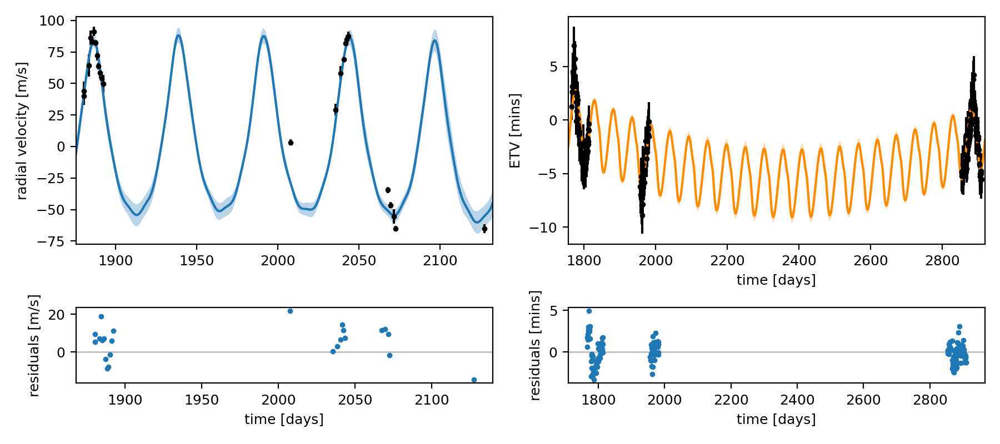

In [19]:
from matplotlib import gridspec


# plot it
fig = plt.figure(figsize=(9, 4)) 

gs = gridspec.GridSpec(2, 2, height_ratios=[3, 1]) 
ax0 = plt.subplot(gs[0])

ax0.errorbar(x, y, yerr=yerr, fmt=".k")

# Compute the posterior predictions for the RV model
pred = np.percentile(trace["rv_model_pred"], [16, 50, 84], axis=0)
ax0.plot(t, pred[1], color="C0", label="model")
art = ax0.fill_between(t, pred[0], pred[2], color="C0", alpha=0.3)
art.set_edgecolor("none")

#ax[0].legend(fontsize=10)
ax0.set_xlim(t.min(), t.max())
ax0.set_ylabel("radial velocity [m/s]")

ax1 = plt.subplot(gs[2])
ax1.plot(x,y - trace["rv_model"][1], '.k', color="C0", label="model")
ax1.axhline(0, color = 'grey', zorder = -1, lw = 1, alpha = 0.5)
ax1.set_xlabel("time [days]")
ax1.set_ylabel("residuals [m/s]")

ax2 = plt.subplot(gs[1])

ax2.errorbar(x_etv, y_etv, yerr=yerr_etv, fmt=".k")
pred = np.percentile(trace["etv_model_pred"], [16, 50, 84], axis=0)
ax2.plot(x_etv_array, pred[1], color="darkorange", label="model")
art = ax2.fill_between(x_etv_array, pred[0], pred[2], color="darkorange", alpha=0.3)
art.set_edgecolor("none")

#ax[1].legend(fontsize=10)
ax2.set_xlim(x_etv_array.min(), x_etv_array.max())
ax2.set_xlabel("time [days]")
ax2.set_ylabel("ETV [mins]")


ax3 = plt.subplot(gs[3])
ax3.plot(x_etv,y_etv - trace["etv_model"][1], '.k', color="C0", label="model")
ax3.axhline(0, color = 'grey', zorder = -1, lw = 1, alpha = 0.5)
ax3.set_xlabel("time [days]")
ax3.set_ylabel("residuals [mins]")


plt.tight_layout()



In [20]:
import collections

def aic(y, y_pred, p):

    n = len(y)

    # Calculation
    resid = np.subtract(y_pred, y)
    rss = np.sum(np.power(resid, 2))
    aic_score = n*np.log(rss/n) + 2*p

    return aic_score


def bic(y, y_pred, p):

    n = len(y)

    # Score

    residual = np.subtract(y_pred, y)
    SSE = np.sum(np.power(residual, 2))
    BIC = n*np.log(SSE/n) + p*np.log(n)
    return BIC

In [21]:
AIC_etv = aic(y_etv, trace["etv_model"][1], 21)
BIC_etv = bic(y_etv, trace["etv_model"][1], 21)

AIC_rv = aic(y, trace["rv_model"][1], 21)
BIC_rv = bic(y, trace["rv_model"][1], 21)




In [22]:
print("AIC_rv                       : {}".format(AIC_rv))
print("BIC_rv                       : {}".format(BIC_rv))
print ("stdv rv residuals            : {}".format(np.std(y - trace["rv_model"][1])))
print ()   
print("AIC_etv                      : {}".format(AIC_etv))
print("BIC_etv                      : {}".format(BIC_etv))
print ("stdv etv residuals           : {} ".format(np.std(y_etv - trace["etv_model"][1])))

print ()
print("AIC_total                    : {}".format(AIC_rv + AIC_etv))
print("BIC_total                    : {}".format(BIC_rv + BIC_etv))


AIC_rv                       : 153.16813513511977
BIC_rv                       : 177.90726557242664
stdv rv residuals            : 8.494891095405832

AIC_etv                      : 151.0686275193168
BIC_etv                      : 218.46783672898664
stdv etv residuals           : 1.3441376976397248 

AIC_total                    : 304.2367626544366
BIC_total                    : 396.3751023014133


In [23]:
import math



In [24]:
total = 1000
side1 = 750
side2 = 250

print(math.factorial(total)/(math.factorial(side1) * math.factorial(side2)))
print((math.factorial(total)/(math.factorial(side1) * math.factorial(side2)))/(2**total)*100)


4.822840391836983e+242
4.500981475549265e-57
